In [1]:
import pandas as pd

df_new5 = pd.read_csv('new5_c.csv',index_col=[0])

In [587]:
cats1 = ['Make',
 'Model',
 'Trim',
 'Series',
 'Trim2',
 'Series2',
 'ABS',
 'AdaptiveCruiseControl',
 'AdaptiveDrivingBeam',
 'AirBagLocCurtain',
 'AirBagLocFront',
 'AirBagLocKnee',
 'AirBagLocSeatCushion',
 'AirBagLocSide',
 'AutoReverseSystem',
 'BedType',
 'BlindSpotMon',
 'BodyCabType',
 'BodyClass',
 'BrakeSystemType',
 'CAN_AACN',
 'CIB',
 'DaytimeRunningLight',
 'Doors',
 'DriveType',
 'DynamicBrakeSupport',
 'ESC',
 'ElectrificationLevel',
 'EngineConfiguration',
 'EngineCylinders',
 'ForwardCollisionWarning',
 'FuelInjectionType',
 'FuelTypePrimary',
 'FuelTypeSecondary',
 'GVWR',
 'KeylessIgnition',
 'LaneDepartureWarning',
 'LaneKeepSystem',
 'LowerBeamHeadlampLightSource',
 'ParkAssist',
 'PedestrianAutomaticEmergencyBraking',
 'Pretensioner',
 'RearCrossTrafficAlert',
 'RearVisibilitySystem',
 'SeatBeltsAll',
 'SeatRows',
 'Seats',
 'SemiautomaticHeadlampBeamSwitching',
 'SteeringLocation',
 'TPMS',
 'TractionControl',
 'TransmissionSpeeds',
 'TransmissionStyle',
 'Turbo',
 'ValveTrainDesign',
 'VehicleType',
 'WheelBaseType',
 'condition',
 'paint_color']

nums1 = ['BasePrice',
 'EngineHP',
 'EngineHP_to',
 'displ',
 'TopSpeedMPH',
 'WheelBaseShort',
 'WheelSizeFront',
 'WheelSizeRear',
 'odometer',
 'ModelYear']

In [3]:
import xgboost as xgb
from xgboost import XGBRegressor

loaded_model = XGBRegressor()
loaded_model.load_model('xgb_model_5.json')

In [4]:
import numpy as np 
np.arange(50000, 300001, 25000)

array([ 50000,  75000, 100000, 125000, 150000, 175000, 200000, 225000,
       250000, 275000, 300000])

In [6]:
cols_to_not_match = ['Make','Model','Series','Series2','Trim','Trim2']

In [513]:
len(df_new5[df_new5.Model == 'Wrangler'])

1473

In [419]:
reg_similars = ['VehicleType', 'DriveType','GVWR', 'Doors','BodyClass', 'EngineCylinders', 'ModelYear', 'displ']

In [ ]:
subset = ['Make','Model','BodyCabType','VehicleType','DriveType','Turbo','Trim','Trim2','Series','Series2', 'GVWR','BodyCabType','Doors','BodyClass', 'displ','EngineCylinders', 'ModelYear']
df_masked = df_new5[df_new5.Model == 'H2'].drop_duplicates(subset=subset)

In [629]:
def find_matches1(model_str, subset=subset, similars=reg_similars, displ_thresh=500):

    #subset = ['Make','Model','BodyCabType','VehicleType','DriveType','Turbo','Trim','Trim2','Series','Series2', 'GVWR','BodyCabType','Doors','BodyClass', 'displ','EngineCylinders', 'ModelYear']
    df_masked = df_new5[df_new5.Model == model_str].drop_duplicates(subset=subset)
    list_of_mask = df_masked.index.tolist()
    
    #reg_similars = ['VehicleType', 'DriveType','GVWR', 'Doors','BodyClass', 'EngineCylinders', 'ModelYear', 'displ', 'Turbo']

    ret_dc = {}
    
    for idx in list_of_mask: 
        matching_rows = df_new5[
            (df_new5[similars] == df_masked.loc[idx, similars]).all(axis=1)
        ]

        if not matching_rows.empty:
            displ_values = matching_rows['displ']
    
            # Ensure all matching 'displ' values are within the threshold of the first one
            if not displ_values.empty:
                filtered_matching_rows = matching_rows[
                    abs(matching_rows['displ'] - displ_values.iloc[0]) <= displ_thresh
                ]            
                
            match_idx = [x for x in matching_rows.index if x not in df_new5[df_new5.Model == model_str].index]
            match_drop = df_new5[df_new5.index.isin(match_idx)].drop_duplicates(subset=cols_to_not_match).index
            if not match_drop.empty:
                ret_dc[idx] = match_drop.tolist()
    return ret_dc, df_masked

In [627]:
reg_similars

['VehicleType',
 'DriveType',
 'GVWR',
 'Doors',
 'BodyClass',
 'EngineCylinders',
 'ModelYear',
 'displ',
 'Turbo']

In [648]:
subset = ['Make','Model','BodyCabType','VehicleType','DriveType','Turbo','Trim','Trim2','Series','Series2', 'GVWR','BodyCabType','Doors','BodyClass', 'displ','EngineCylinders', 'ModelYear']
df_masked = df_new5[df_new5.Model == 'Wrangler'].drop_duplicates(subset=subset)

In [663]:
n_similars

['BodyCabType',
 'VehicleType',
 'DriveType',
 'GVWR',
 'Doors',
 'BodyClass',
 'EngineCylinders',
 'ModelYear']

In [664]:
x_similars = ['VehicleType',
 'DriveType',
 'GVWR',
 'Doors',
 'BodyClass',
 'EngineCylinders',
 'ModelYear']

In [651]:
d3s, df_masked = find_matches1('Sierra HD', similars=x_similars)

In [ ]:
d2s

In [ ]:
for k in d2s.keys():
    mask_plot_row1(k, df_new5, 'Wrangler', model1, ['VehicleType',
 'DriveType',
 'GVWR',
 'Doors',
 'BodyClass',
 'EngineCylinders',
 'ModelYear'])

In [679]:
big_trucks = n_similars+['Turbo', 'FuelTypePrimary']

In [686]:
n_similars

['BodyCabType',
 'VehicleType',
 'DriveType',
 'GVWR',
 'Doors',
 'BodyClass',
 'EngineCylinders',
 'ModelYear']

In [685]:
df_new5[df_new5.Model == 'XT6'][subset]

,Make,Model,BodyCabType,VehicleType,DriveType,Turbo,Trim,Trim2,Series,Series2,GVWR,BodyCabType,Doors,BodyClass,displ,EngineCylinders,ModelYear
11005,CADILLAC,XT6,NaN,MULTIPURPOSE PASSENGER VEHICLE (MPV),FWD,0,NaN,NaN,Premium Luxury FWD,NaN,"Class 2E: 6,001 - 7,000 lb (2,722 - 3,175 kg)",NaN,4.0,Sport Utility Vehicle (SUV)/Multi-Purpose Vehi...,3600.0,6.0,2020.0
15716,CADILLAC,XT6,NaN,MULTIPURPOSE PASSENGER VEHICLE (MPV),AWD,0,NaN,NaN,Premium Luxury AWD,NaN,"Class 2E: 6,001 - 7,000 lb (2,722 - 3,175 kg)",NaN,4.0,Sport Utility Vehicle (SUV)/Multi-Purpose Vehi...,3600.0,6.0,2020.0
15737,CADILLAC,XT6,NaN,MULTIPURPOSE PASSENGER VEHICLE (MPV),FWD,0,NaN,NaN,Premium Luxury FWD,NaN,"Class 2E: 6,001 - 7,000 lb (2,722 - 3,175 kg)",NaN,4.0,Sport Utility Vehicle (SUV)/Multi-Purpose Vehi...,3600.0,6.0,2020.0
18159,CADILLAC,XT6,NaN,MULTIPURPOSE PASSENGER VEHICLE (MPV),FWD,0,NaN,NaN,Premium Luxury FWD,NaN,"Class 2E: 6,001 - 7,000 lb (2,722 - 3,175 kg)",NaN,4.0,Sport Utility Vehicle (SUV)/Multi-Purpose Vehi...,3600.0,6.0,2020.0
18220,CADILLAC,XT6,NaN,MULTIPURPOSE PASSENGER VEHICLE (MPV),FWD,0,NaN,NaN,Premium Luxury FWD,NaN,"Class 2E: 6,001 - 7,000 lb (2,722 - 3,175 kg)",NaN,4.0,Sport Utility Vehicle (SUV)/Multi-Purpose Vehi...,3600.0,6.0,2020.0
18222,CADILLAC,XT6,NaN,MULTIPURPOSE PASSENGER VEHICLE (MPV),FWD,0,NaN,NaN,Premium Luxury FWD,NaN,"Class 2E: 6,001 - 7,000 lb (2,722 - 3,175 kg)",NaN,4.0,Sport Utility Vehicle (SUV)/Multi-Purpose Vehi...,3600.0,6.0,2020.0
25799,CADILLAC,XT6,NaN,MULTIPURPOSE PASSENGER VEHICLE (MPV),AWD,0,NaN,NaN,Sport AWD,NaN,"Class 2E: 6,001 - 7,000 lb (2,722 - 3,175 kg)",NaN,4.0,Sport Utility Vehicle (SUV)/Multi-Purpose Vehi...,3600.0,6.0,2020.0
39384,CADILLAC,XT6,NaN,MULTIPURPOSE PASSENGER VEHICLE (MPV),AWD,0,NaN,NaN,Premium Luxury AWD,NaN,"Class 2E: 6,001 - 7,000 lb (2,722 - 3,175 kg)",NaN,4.0,Sport Utility Vehicle (SUV)/Multi-Purpose Vehi...,3600.0,6.0,2020.0
41039,CADILLAC,XT6,NaN,MULTIPURPOSE PASSENGER VEHICLE (MPV),AWD,0,NaN,NaN,Premium Luxury AWD,NaN,"Class 2E: 6,001 - 7,000 lb (2,722 - 3,175 kg)",NaN,4.0,Sport Utility Vehicle (SUV)/Multi-Purpose Vehi...,3600.0,6.0,2020.0
42739,CADILLAC,XT6,NaN,MULTIPURPOSE PASSENGER VEHICLE (MPV),FWD,0,NaN,NaN,Premium Luxury FWD,NaN,"Class 2E: 6,001 - 7,000 lb (2,722 - 3,175 kg)",NaN,4.0,Sport Utility Vehicle (SUV)/Multi-Purpose Vehi...,3600.0,6.0,2020.0


In [687]:
d4s, df_masked = find_matches1('XT6', similars= reg_similars)

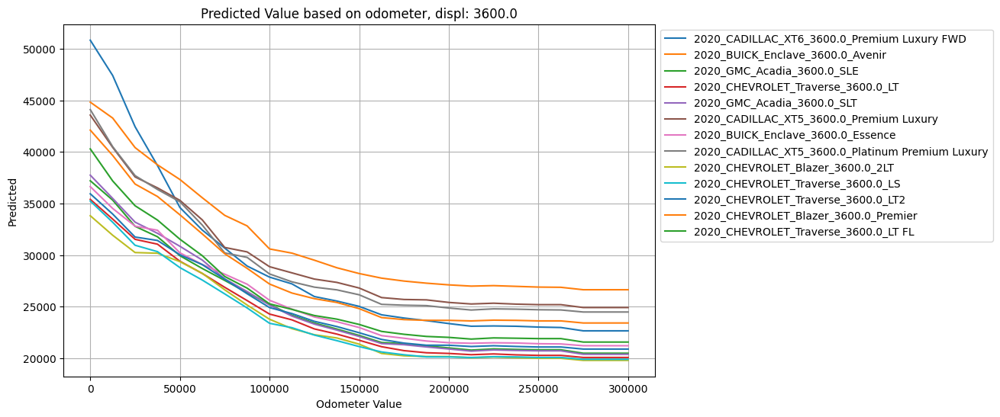

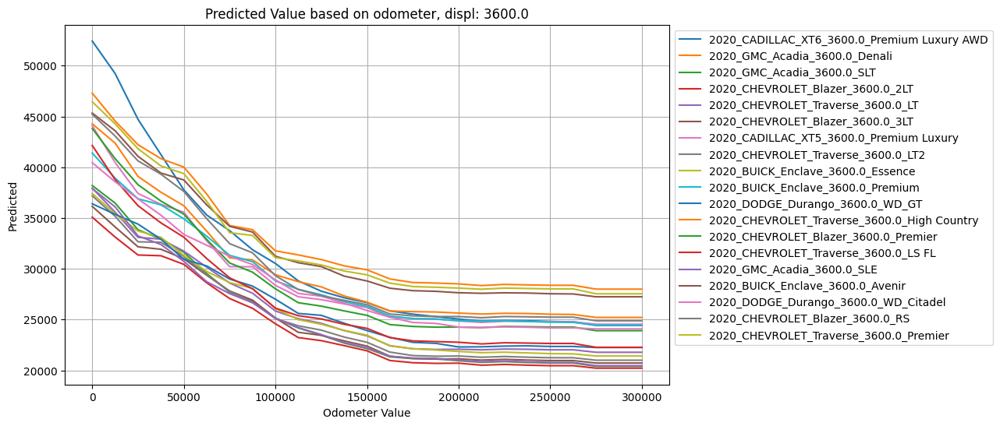

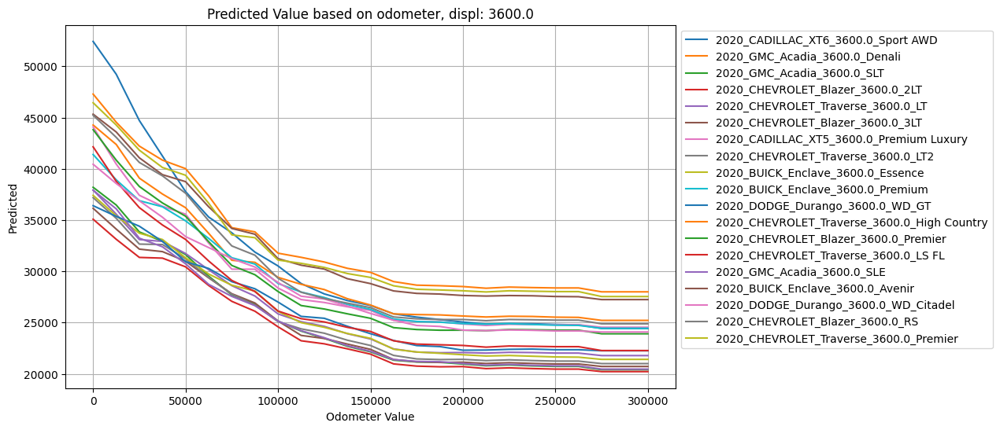

In [688]:
for k in d4s.keys():
    mask_plot_row1(k, df_new5, 'XT6', model1, reg_similars)

In [680]:
d3s, df_masked = find_matches1('Sierra HD', similars= big_trucks)

In [673]:
[x for x in df_new5.columns if 'Bed' in x]

['BedType']

In [668]:
n_similars

['BodyCabType',
 'VehicleType',
 'DriveType',
 'GVWR',
 'Doors',
 'BodyClass',
 'EngineCylinders',
 'ModelYear']

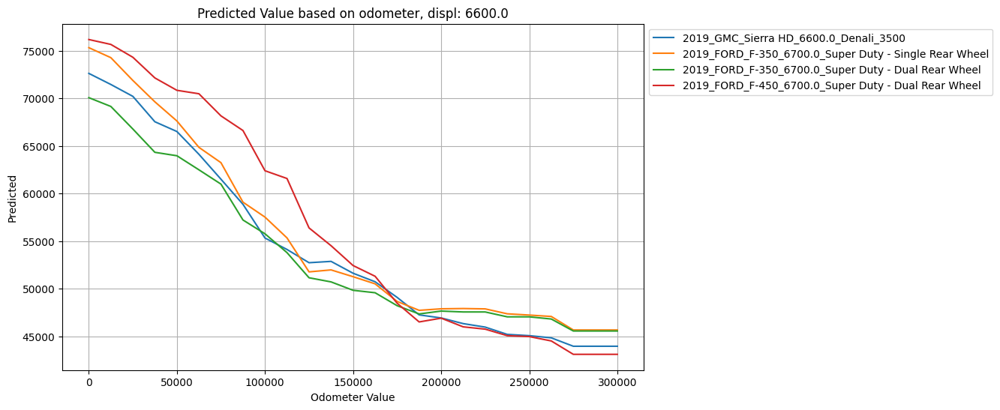

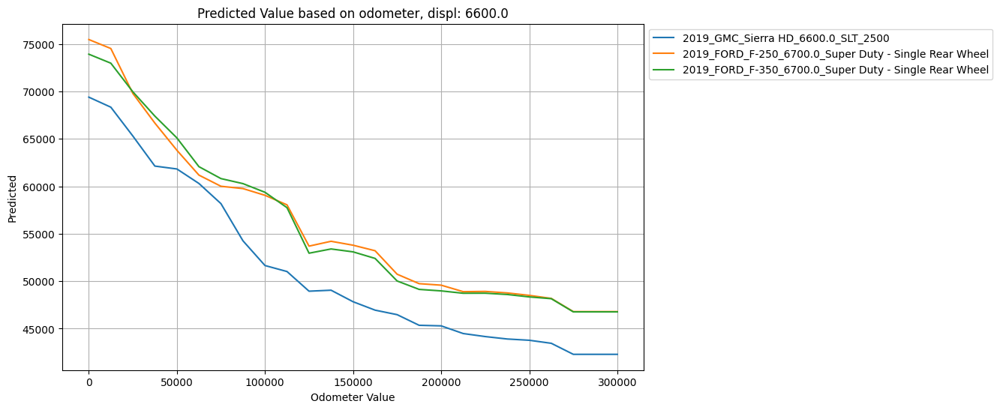

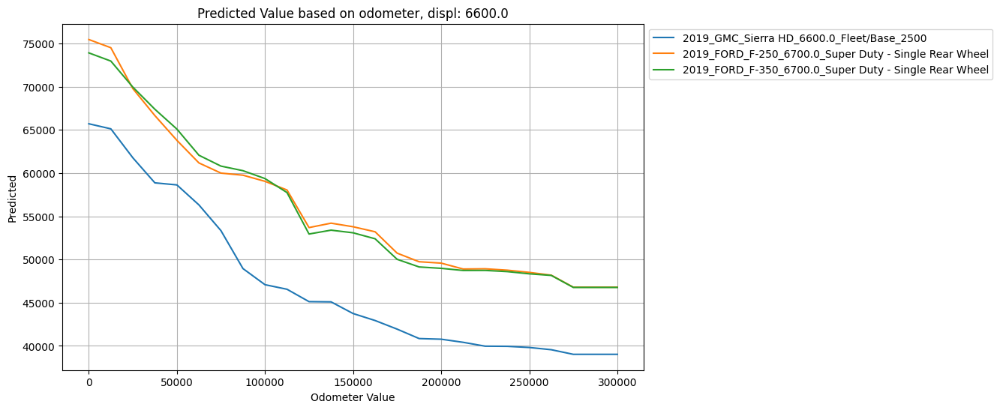

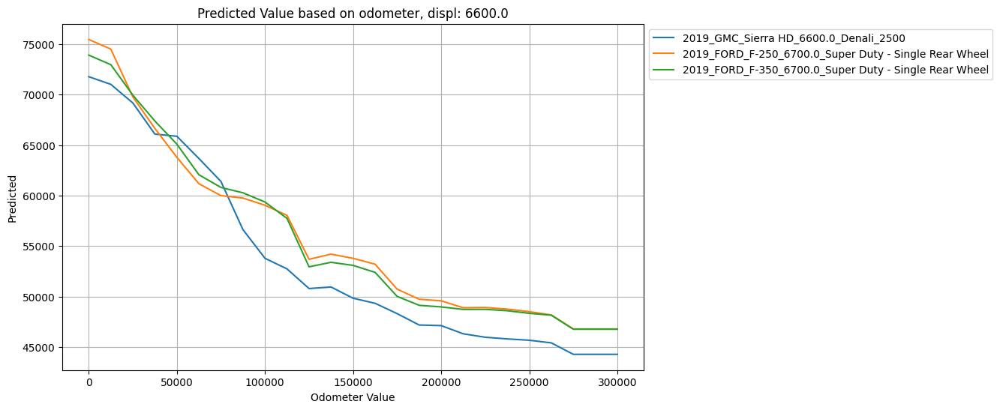

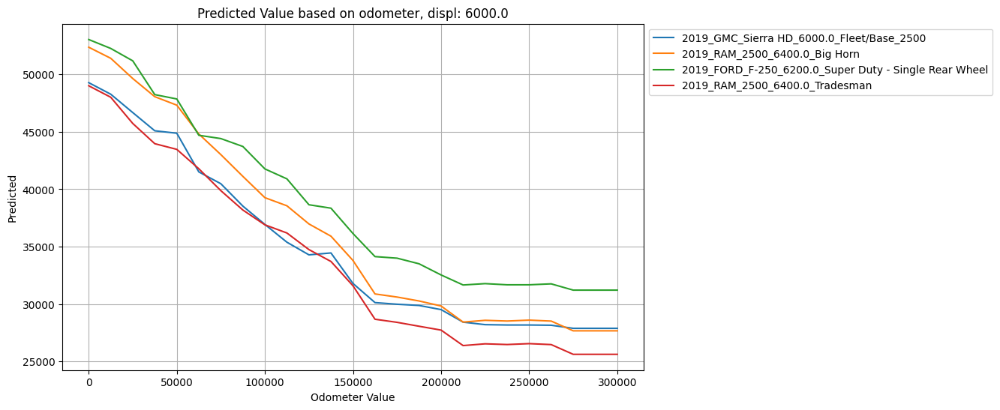

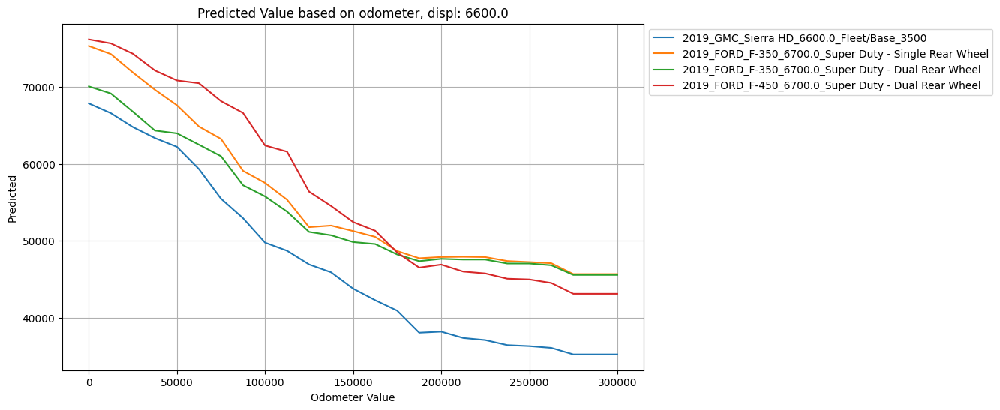

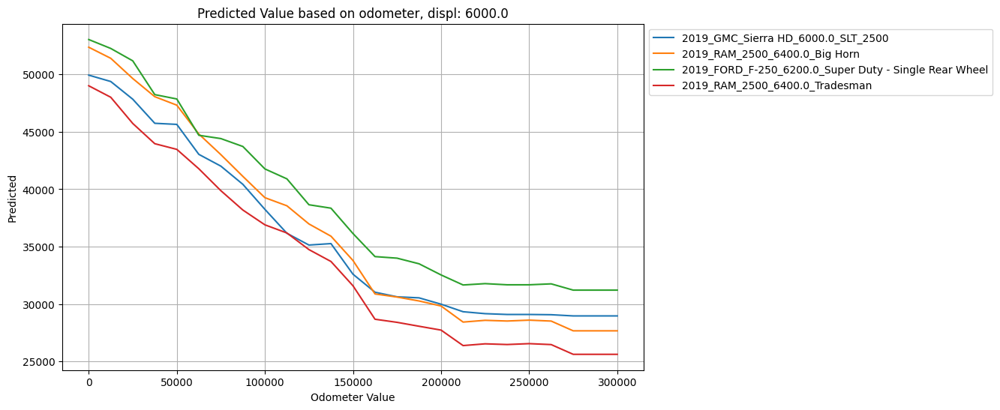

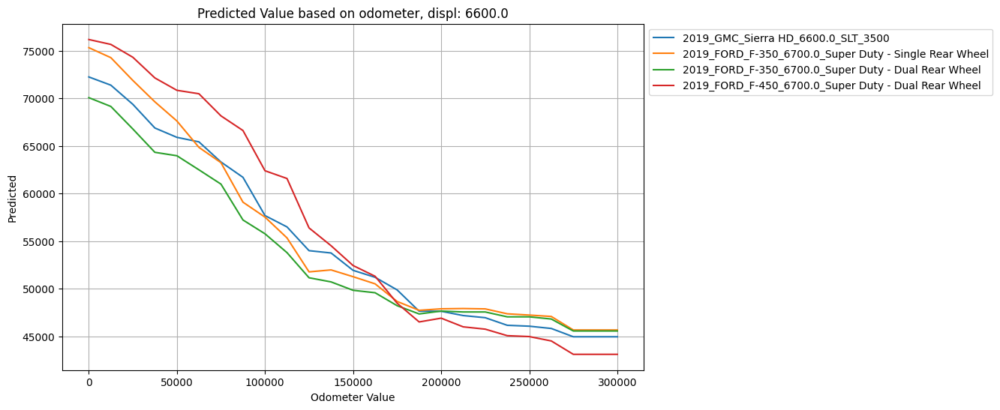

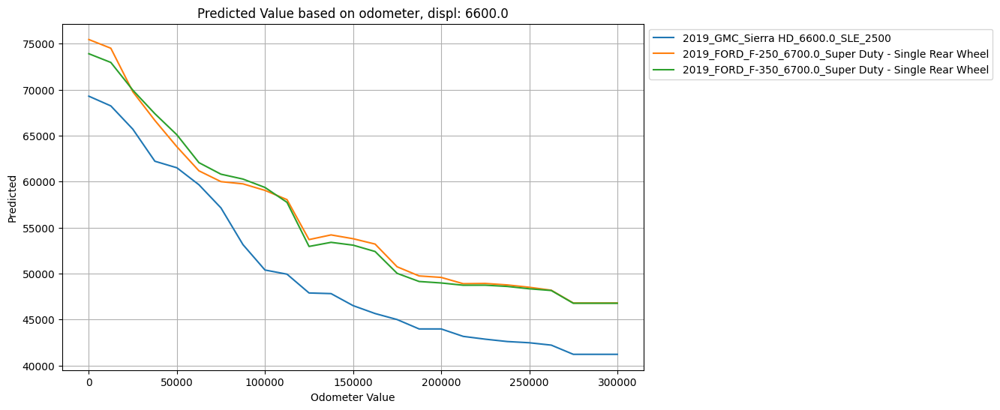

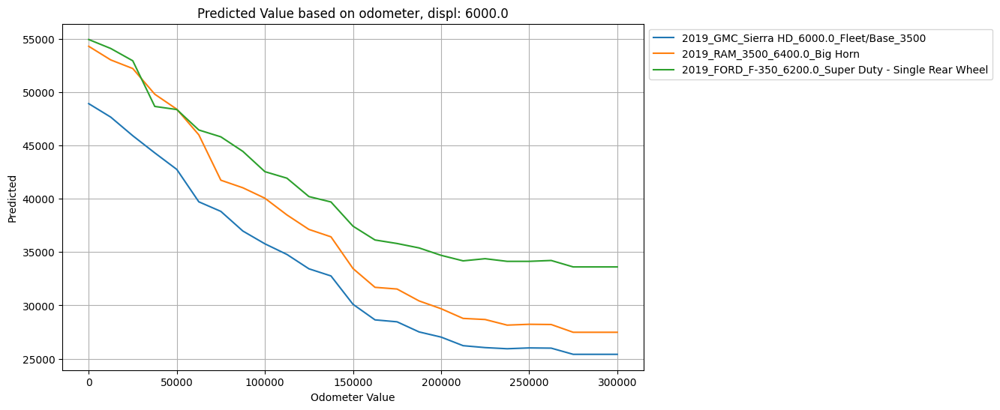

In [681]:
for k in d3s.keys():
    mask_plot_row1(k, df_new5, 'Sierra HD', model1, big_trucks)

In [641]:
d1s, df_masked = find_matches1('TLX', similars=n_similars)

In [684]:
feature_importances_df.head(10).set_index('Feature')

,Importance
Feature,
TractionControl_Standard,0.152273
RearVisibilitySystem_Standard,0.067426
SemiautomaticHeadlampBeamSwitching_Standard,0.052178
BodyCabType_Crew/Super Crew/Crew Max,0.050074
ESC_Standard,0.040093
BodyClass_Pickup,0.025125
FuelTypePrimary_Diesel,0.024975
EngineCylinders,0.018596
VehicleType_TRUCK,0.012034


In [659]:
feature_importances_df[feature_importances_df.Feature.str.contains('Model_')].head(25)

,Feature,Importance
145,Model_911,0.005904
775,Model_Wrangler,0.004085
715,Model_TLX,0.003151
685,Model_Sierra HD,0.002492
802,Model_XT6,0.002194
327,Model_EuroVan,0.002169
58,Model_2500,0.002094
690,Model_Silverado LD,0.002074
343,Model_FJ Cruiser,0.002047
271,Model_Corvette,0.001895


In [660]:
feature_importances_df[feature_importances_df.Feature.str.contains('Make_')].head(25)

,Feature,Importance
39,Make_PORSCHE,0.003383
25,Make_JEEP,0.002809
27,Make_LAND ROVER,0.002344
32,Make_MERCEDES-BENZ,0.001840
40,Make_RAM,0.001834
9,Make_BMW,0.001098
36,Make_NISSAN,0.000990
7,Make_ALFA ROMEO,0.000939
14,Make_DODGE,0.000867
45,Make_TOYOTA,0.000859


In [661]:
feature_importances_df[feature_importances_df.Feature.str.contains('Series_')].head(25)

,Feature,Importance
2773,Series_AGZ10L/AGZ15L/AYZ15L,0.007837
3994,Series_UPK51L/UPK56L/USK51L/USK52L/USK56L/USK57L,0.004872
3111,Series_F-Series,0.003976
3289,Series_GYL25L/GGL25L/GGL20L/GYL20L,0.003669
2953,Series_Carrera,0.003492
3769,Series_SL550,0.002573
3406,Series_Laramie,0.002503
3235,Series_GRN305L,0.002423
3247,Series_GSJ10L/GSJ15L,0.002403
4007,Series_UVF46L,0.002295


In [662]:
feature_importances_df[feature_importances_df.Feature.str.contains('Trim_')].head(25)

,Feature,Importance
1451,Trim_JL,0.003994
2233,Trim_Styleside,0.003732
2239,Trim_Super Crew - Raptor,0.003114
2333,Trim_Unlimited Sahara,0.001722
1923,Trim_Raptor SVT,0.001701
1126,"Trim_Base (2WD), 4 (4WD)",0.001606
1452,Trim_JL (Open Body),0.001551
2133,Trim_Sahara,0.001526
1409,Trim_HSE,0.001470
1251,Trim_Denali,0.001459


In [691]:
x_similars

['VehicleType',
 'DriveType',
 'GVWR',
 'Doors',
 'BodyClass',
 'EngineCylinders',
 'ModelYear']

In [ ]:
d2b, df_masked = find_matches1('911',similars=['BodyClass',  'DriveType', 'Doors','EngineCylinders', 'ModelYear'])
d2b

In [ ]:
for k in d3b.keys():
    mask_plot_row1(k, df_new5, '911', model1, ['BodyClass',  'DriveType', 'Doors','EngineCylinders', 'ModelYear', 'Turbo'])

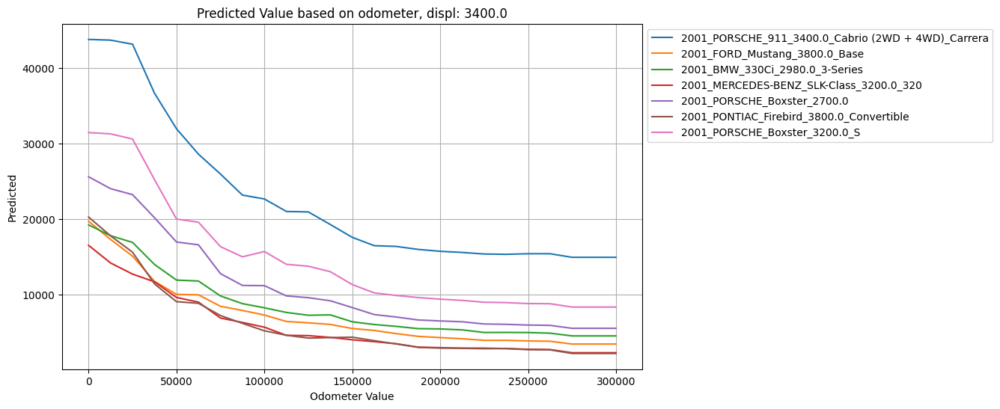

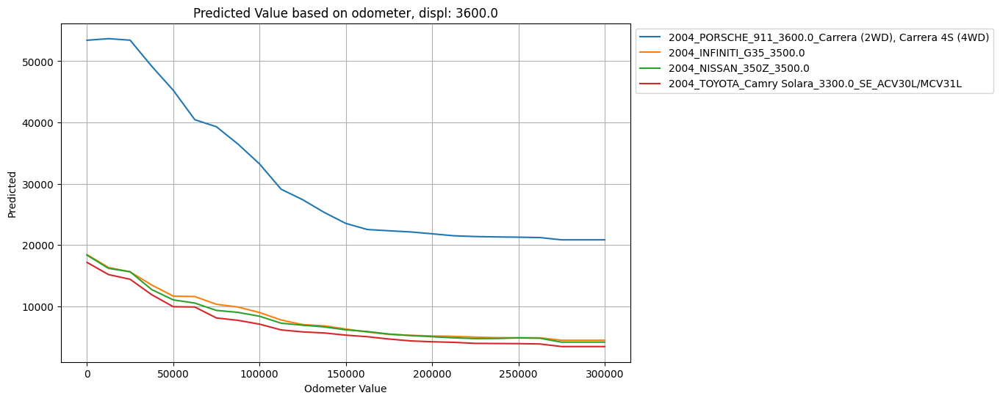

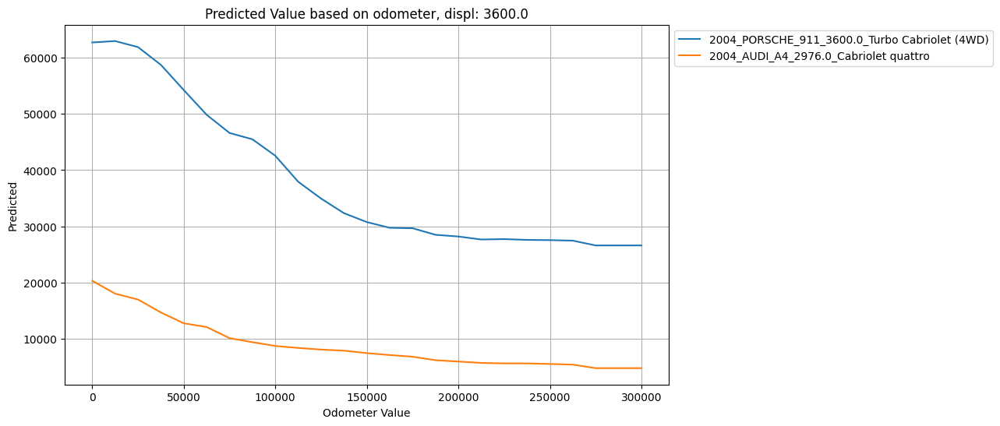

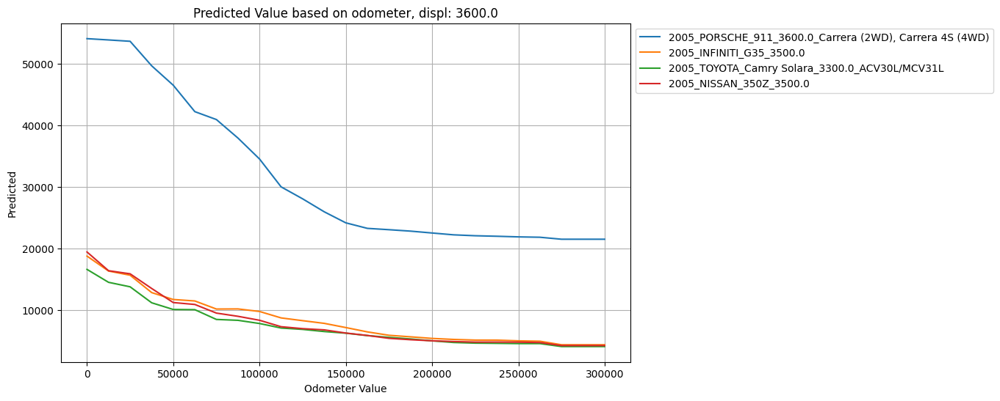

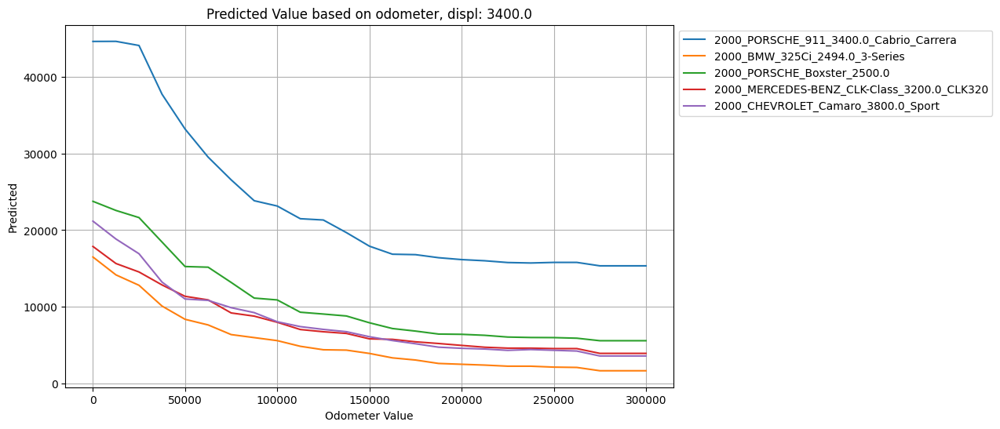

...

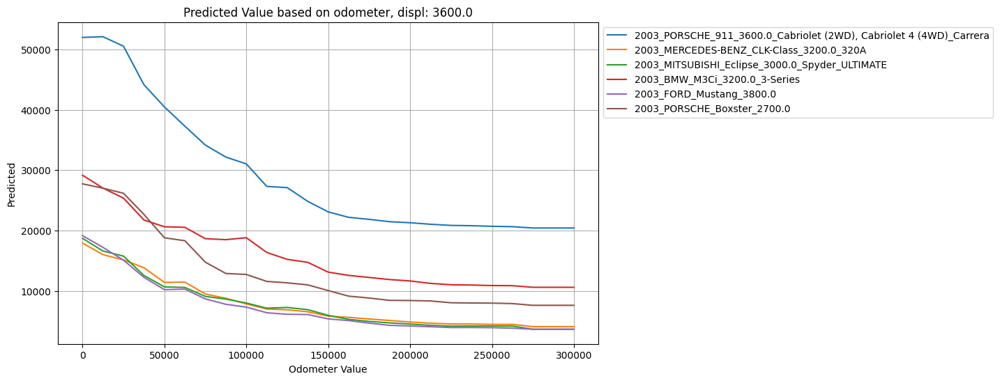

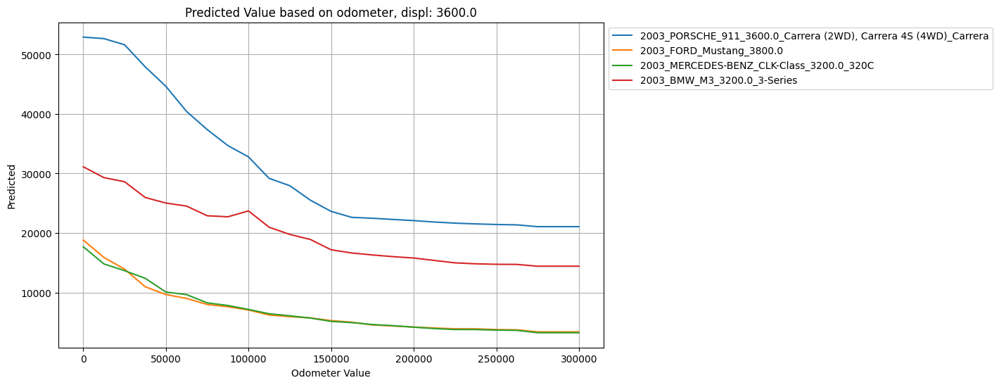

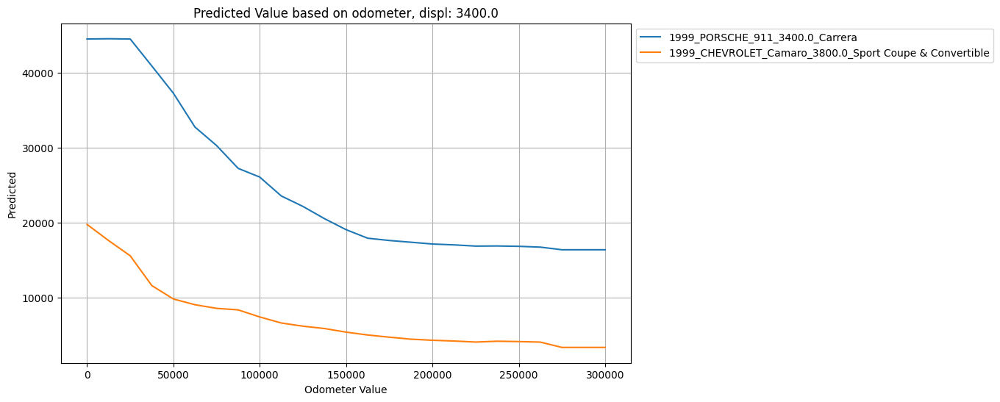

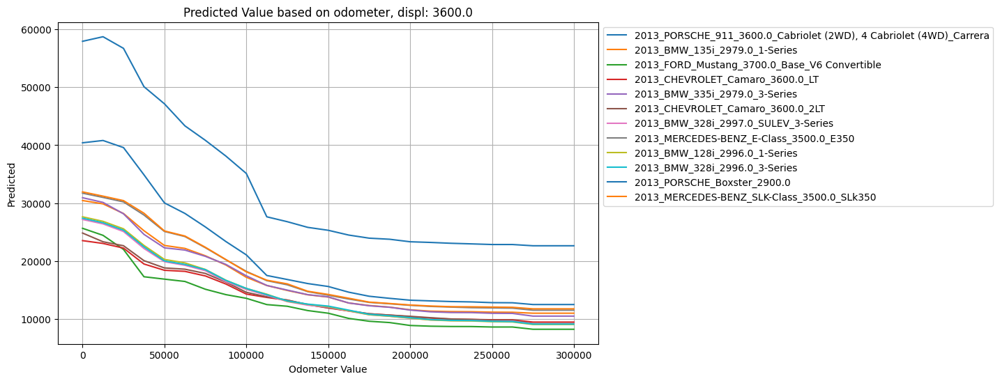

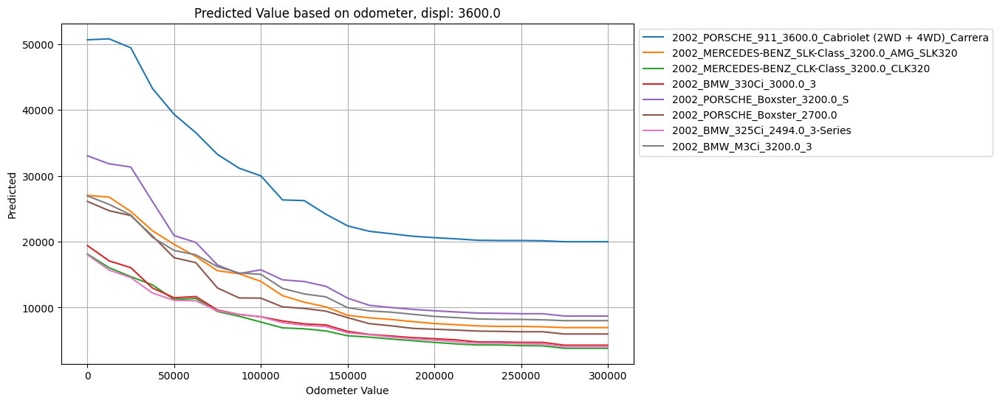

In [721]:
for k in d2b.keys():
    mask_plot_row1(k, df_new5, '911', model1, ['BodyClass',  'DriveType', 'Doors','EngineCylinders', 'ModelYear'])

In [ ]:
for k in d1s.keys():
    mask_plot_row1(k, df_new5, '911', model1, n_similars)

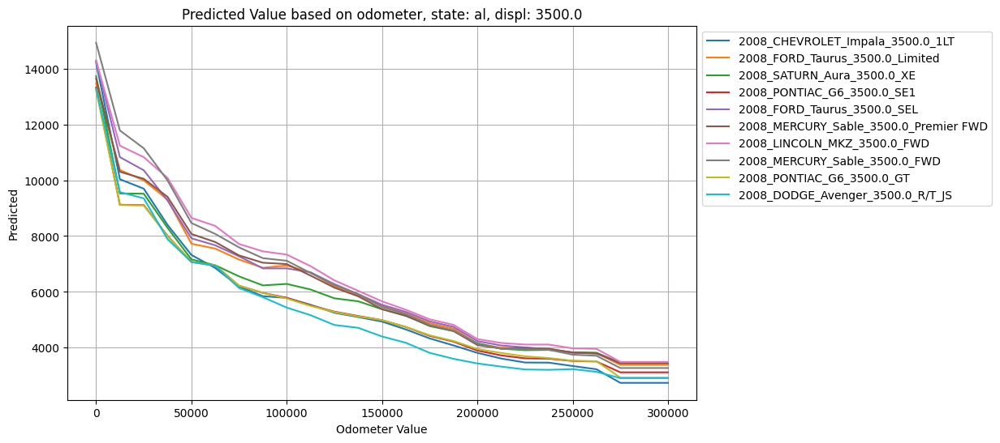

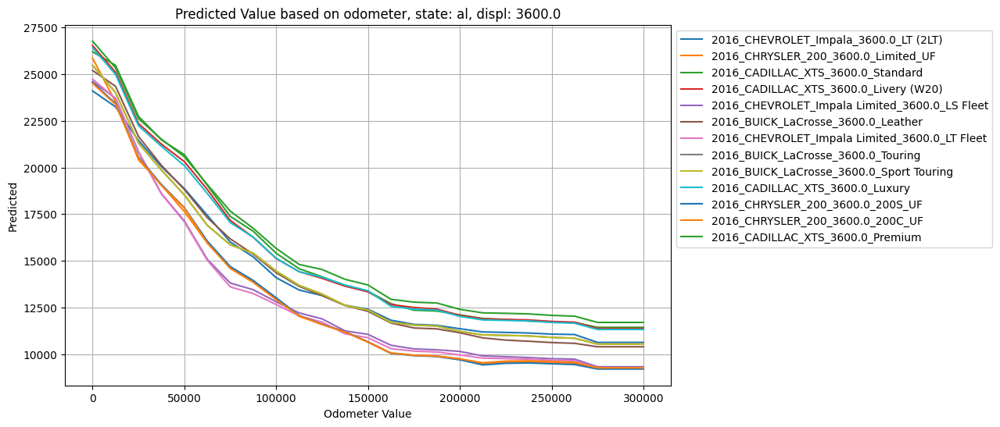

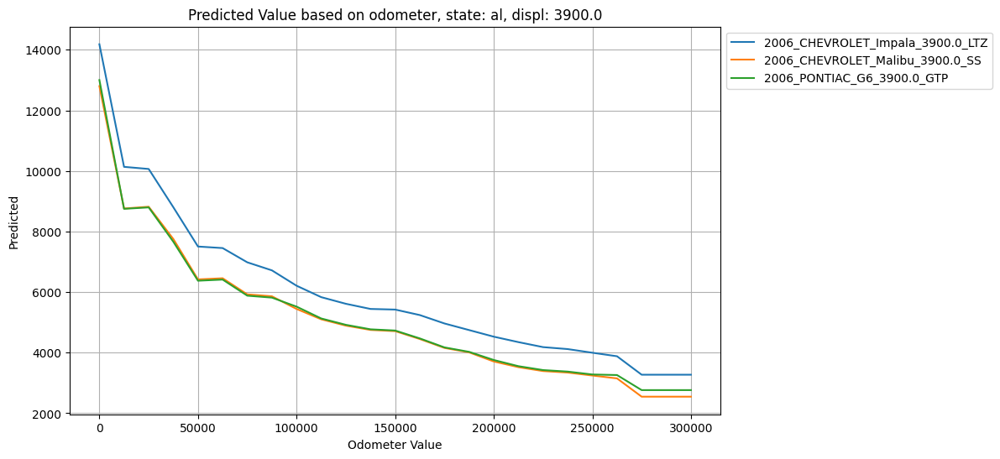

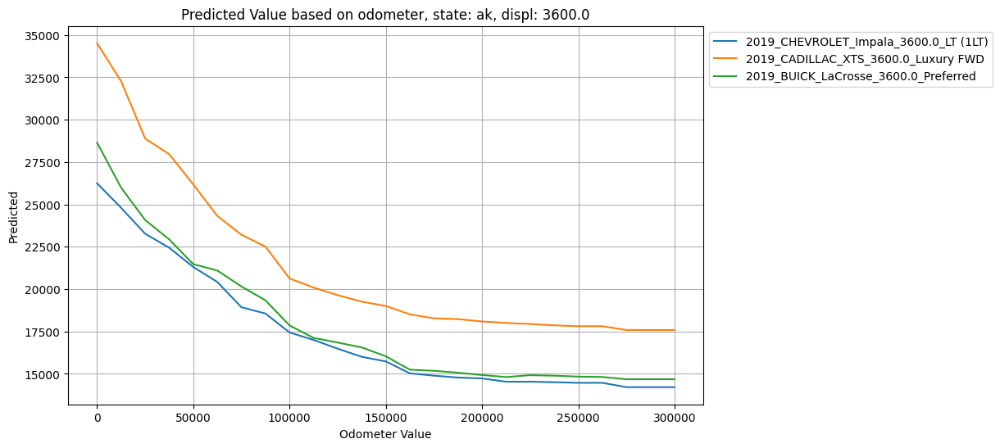

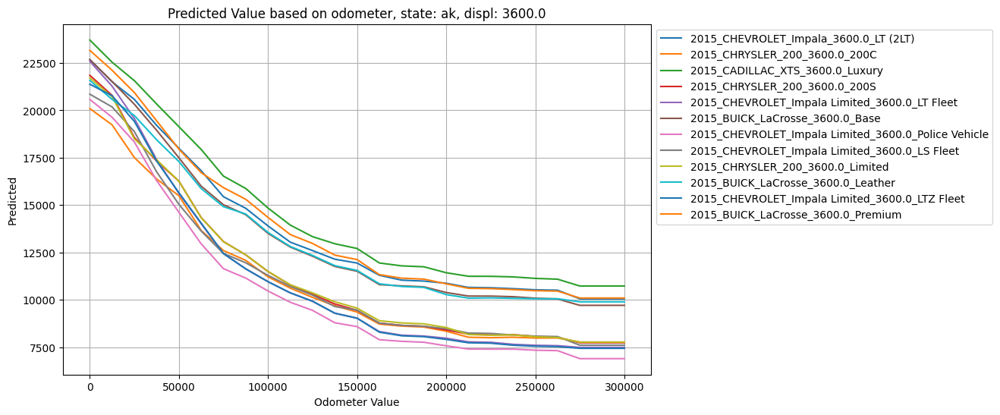

...

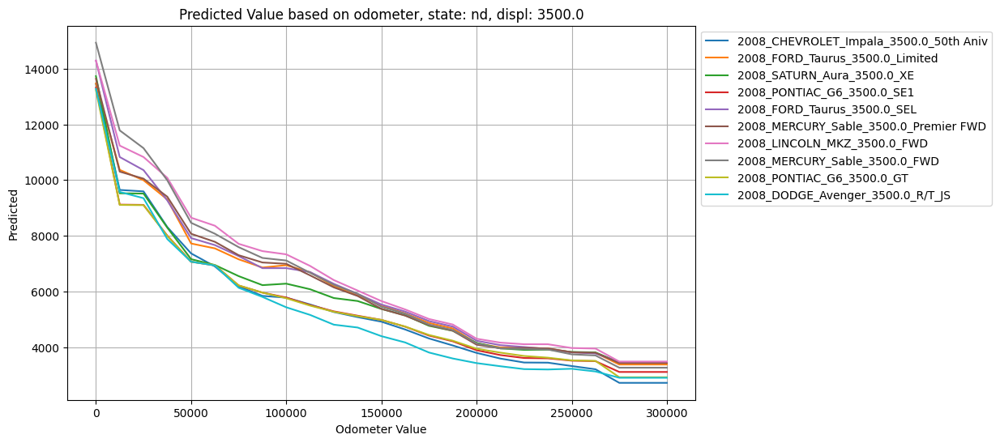

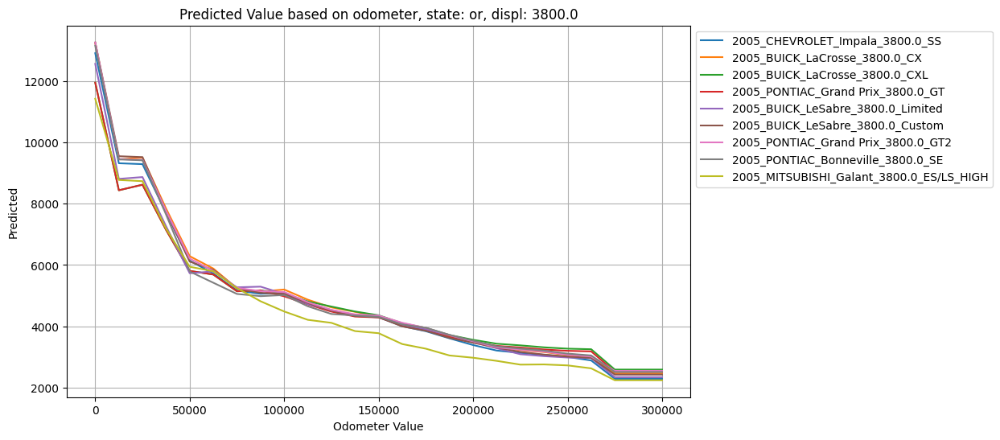

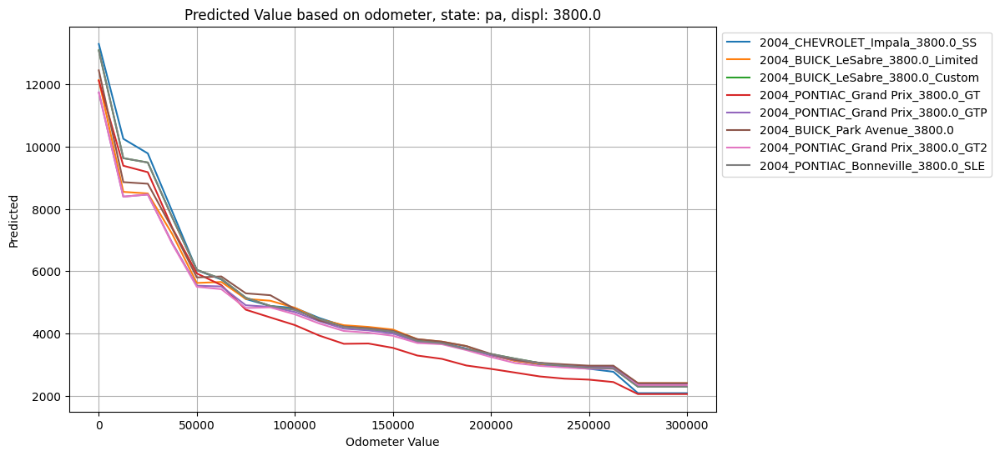

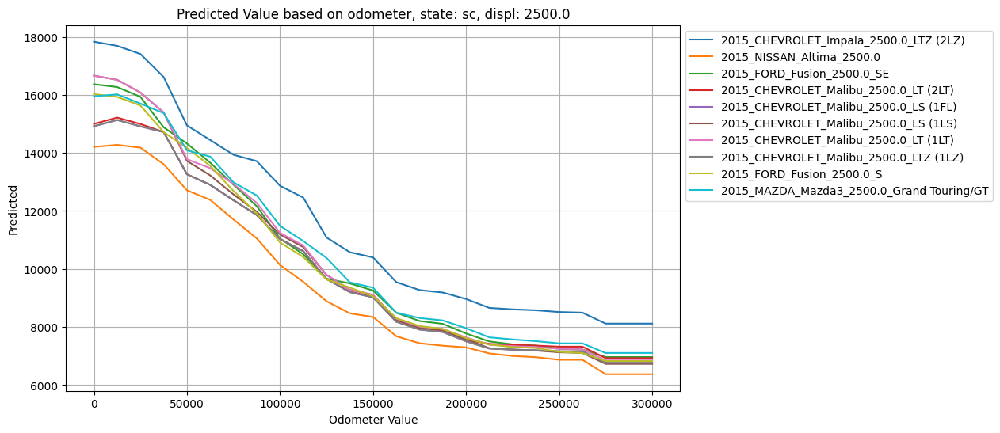

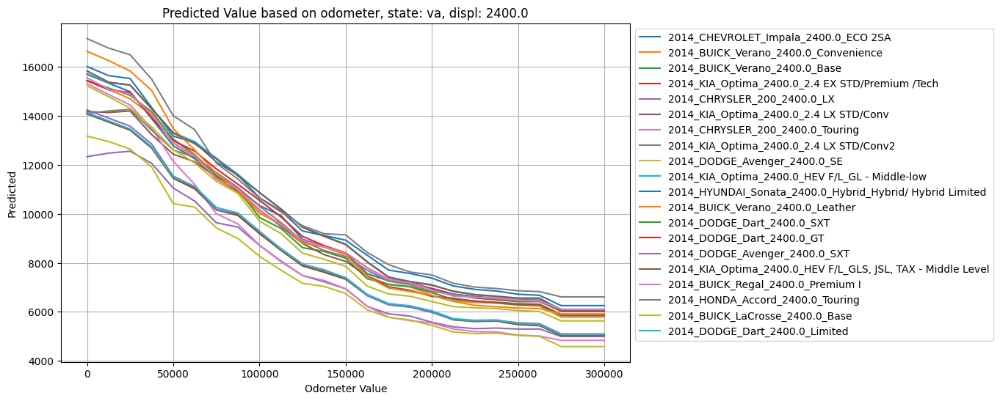

In [613]:
for k in dds.keys():
    mask_plot_row1(k, df_new5, 'TLX', model1, reg_similars)

In [578]:
df_new5.loc[516, ['state','state_income','region']]

state                   al
state_income         49671
region          birmingham
Name: 516, dtype: object

In [579]:
df_new5.loc[7594, ['state','state_income','region']]

state              ca
state_income    76800
region          chico
Name: 7594, dtype: object

In [ ]:
for k in ret_dc.keys():
    mask_plot_row(k, df_new5, '911', sims, only_keep_regional=True)

In [ ]:
for k in d1.keys():
    mask_plot_row(k, df_new5, 'Wrangler', reg_similars, only_keep_regional=True)

In [625]:
def mask_plot_row1(idx, df_new5, model_str, loaded_model, overlaps):
    matching_rows = df_new5[
        (df_new5[overlaps] == df_masked.loc[idx, overlaps]).all(axis=1)
    ]

    if matching_rows.empty:
        overlaps = [x for x in overlaps if x != 'displ']
        matching_rows = df_new5[
            (df_new5[overlaps] == df_masked.loc[idx, overlaps]).all(axis=1)
        ]
    match_idx = [x for x in matching_rows.index if x not in df_new5[df_new5.Model == model_str].index]
    match_drop = df_new5[df_new5.index.isin(match_idx)].drop_duplicates(subset=cols_to_not_match).index
    labs, list_df = predict_variations1(idx,match_drop, loaded_model, df_new5)
    r_dc = dict(zip(labs, list_df))
    
    plt.figure(figsize=(10, 6)) 
    
    for label, df in r_dc.items():
        plt.plot(df['odometer'], df['predicted'], label=label)
    
    # Set labels and title
    plt.xlabel('Odometer Value')
    plt.ylabel('Predicted')
    plt.title('Predicted Value based on odometer, displ: ' + str(df_new5.loc[idx, 'displ']))
    plt.grid(True)
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
    plt.show()

In [529]:
def mask_plot_row(idx, df_new5, model_str, similars, only_keep_regional=False):
    matching_rows = df_new5[
        (df_new5[similars] == df_masked.loc[idx, similars]).all(axis=1)
    ]

    if matching_rows.empty:
        similars = [x for x in similars if x != 'displ']
        matching_rows = df_new5[
            (df_new5[similars] == df_masked.loc[idx, similars]).all(axis=1)
        ]
    match_idx = [x for x in matching_rows.index if x not in df_new5[df_new5.Model == model_str].index]
    match_drop = df_new5[df_new5.index.isin(match_idx)].drop_duplicates(subset=cols_to_not_match).index
    labs, list_df = predict_variations(idx,match_drop, loaded_model, df_new5,only_keep_regional=only_keep_regional)
    r_dc = dict(zip(labs, list_df))
    
    plt.figure(figsize=(10, 6)) 
    
    for label, df in r_dc.items():
        plt.plot(df['odometer'], df['predicted'], label=label)
    
    # Set labels and title
    plt.xlabel('Odometer Value')
    plt.ylabel('Predicted')
    plt.title('Predicted Value based on odometer, state: ' + df_new5.loc[idx, 'state'] + ', displ: ' + str(df_new5.loc[idx, 'displ']))
    plt.grid(True)
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
    plt.show()

In [606]:
silv_hd = df_new5[df_new5.Model == 'Sierra HD']
sier_hd = df_new5[df_new5.Model == 'Silverado HD']

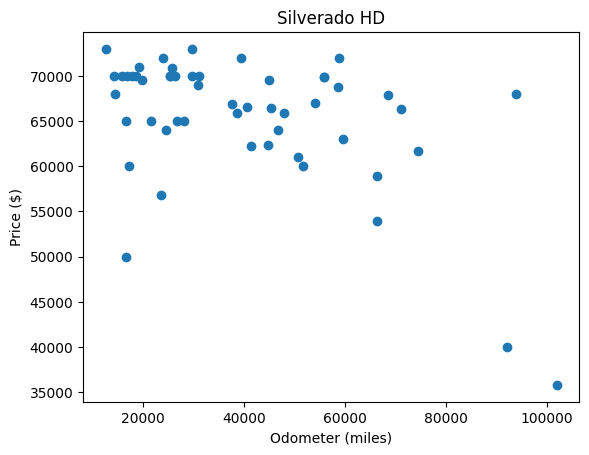

In [607]:
plt.scatter(silv_hd['odometer'], silv_hd['price'])
# Set title and labels
plt.title('Silverado HD')
plt.xlabel('Odometer (miles)')
plt.ylabel('Price ($)')

# Show the plot
plt.show()

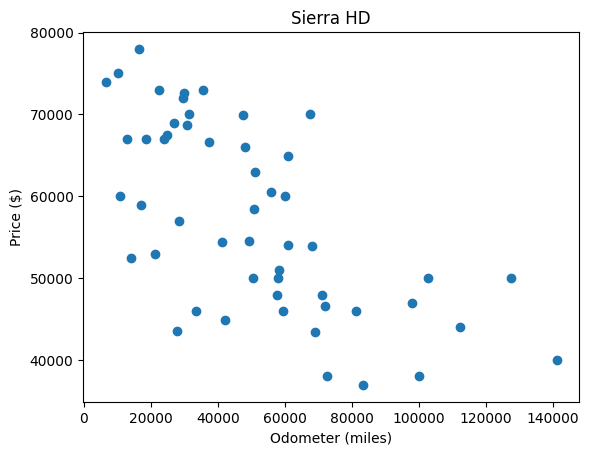

In [608]:
plt.scatter(sier_hd['odometer'], sier_hd['price'])
# Set title and labels
plt.title('Sierra HD')
plt.xlabel('Odometer (miles)')
plt.ylabel('Price ($)')

# Show the plot
plt.show()

In [384]:
df_masked.index

Index([    8,    17,    36,    42,    64,    65,    85,   273,   329,   333,
       ...
       59031, 60314, 64759, 69133, 71630, 75492, 77547, 85299, 85558, 88522],
      dtype='int64', length=151)

In [299]:
def create_hybrid_row(idx1, idx2, cols_from_idx2):
    
    new_row = pd.Series()
    
    for col in cols_from_idx2:
        new_row[col] = df_new5.loc[idx2, col]  # Values from index1
    
    for col in [x for x in df_new5.columns if x not in cols_from_idx2]:
        new_row[col] = df_new5.loc[idx1, col]  # Values from index2
    
    return new_row

In [493]:
def create_hybrid_row_regional(idx1, idx2, cols_from_idx2):
    
    new_row = pd.Series()
    
    for col in cols_from_idx2 + [x for x in df_new5.columns if x not in cols_from_idx2+['state','state_income','region']]:
        new_row[col] = df_new5.loc[idx2, col]  # Values from index1
    
    for col in ['state','state_income','region']:
        new_row[col] = df_new5.loc[idx1, col]  # Values from index2
    
    return new_row

In [ ]:
118, [330, model1, df_new5

In [494]:
#assumes df = df_new5
#X = X

def predict_variations(ref_i, list_of_idx, loaded_model, df, only_keep_regional=False):
    labels = []
    list_of_df = []

    booster = loaded_model.get_booster()
    feature_names = booster.feature_names
    
    row = create_odometer_variations(X.loc[ref_i]).reindex(columns=feature_names)
    lab_str = str(int(df.loc[ref_i, 'ModelYear'])) + '_' + df.loc[ref_i, 'Make'] + '_' + df.loc[ref_i, 'Model'] + '_' + str(df.loc[ref_i, 'displ'])
    
    trim = df.loc[ref_i, 'Trim']
    if pd.notnull(trim):
        lab_str = lab_str + '_' + trim
    
    srs = df.loc[ref_i, 'Series']
    if pd.notnull(srs):
        lab_str = lab_str + '_' + srs
        
    labels.append(lab_str)
    
    y_pred = loaded_model.predict(row)
    row['predicted'] = y_pred
    list_of_df.append(row)

    for i in list_of_idx:
                
        lab_str = str(int(df.loc[i, 'ModelYear'])) + '_' + df.loc[i, 'Make'] + '_' + df.loc[i, 'Model'] + '_' + str(df.loc[i, 'displ'])
        
        trim = df.loc[i, 'Trim']
        if pd.notnull(trim):
            lab_str = lab_str + '_' + trim

        
        srs =df.loc[i, 'Series']
        if pd.notnull(srs):
            lab_str = lab_str + '_' + srs
        
        if lab_str in labels:
            lab_str = lab_str + '2'
            
        labels.append(lab_str)
        
        if only_keep_regional:
            row = create_hybrid_row_regional(ref_i, i, cols_to_not_match)
        else:
            row = create_hybrid_row(ref_i, i, cols_to_not_match)
            
        odo_row = create_odometer_variations(row).reindex(columns=feature_names)

        y_pred = loaded_model.predict(odo_row)
        odo_row['predicted'] = y_pred
        list_of_df.append(odo_row)

    return labels, list_of_df

In [505]:
#assumes df = df_new5
#X = X

def predict_variations1(ref_i, list_of_idx, loaded_model, df):
    labels = []
    list_of_df = []

    booster = loaded_model.get_booster()
    feature_names = booster.feature_names
    
    row = create_odometer_variations(X.loc[ref_i]).reindex(columns=feature_names)
    lab_str = str(int(df.loc[ref_i, 'ModelYear'])) + '_' + df.loc[ref_i, 'Make'] + '_' + df.loc[ref_i, 'Model'] + '_' + str(df.loc[ref_i, 'displ'])
    
    trim = df.loc[ref_i, 'Trim']
    if pd.notnull(trim):
        lab_str = lab_str + '_' + trim
    
    srs = df.loc[ref_i, 'Series']
    if pd.notnull(srs):
        lab_str = lab_str + '_' + srs
        
    labels.append(lab_str)
    
    y_pred = loaded_model.predict(row)
    row['predicted'] = y_pred
    list_of_df.append(row)

    for i in list_of_idx:
                
        lab_str = str(int(df.loc[i, 'ModelYear'])) + '_' + df.loc[i, 'Make'] + '_' + df.loc[i, 'Model'] + '_' + str(df.loc[i, 'displ'])
        
        trim = df.loc[i, 'Trim']
        if pd.notnull(trim):
            lab_str = lab_str + '_' + trim

        
        srs =df.loc[i, 'Series']
        if pd.notnull(srs):
            lab_str = lab_str + '_' + srs
        
        if lab_str in labels:
            lab_str = lab_str + '2'
            
        labels.append(lab_str)
            
        odo_row = create_odometer_variations(X.loc[i]).reindex(columns=feature_names)

        y_pred = loaded_model.predict(odo_row)
        odo_row['predicted'] = y_pred
        list_of_df.append(odo_row)

    return labels, list_of_df

In [291]:
df_new5.loc[6783, subset]

Make                                                    CHEVROLET
Model                                                Silverado HD
BodyCabType                              Crew/Super Crew/Crew Max
VehicleType                                                 TRUCK
DriveType                                                     4WD
Turbo                                                           1
Trim                                                           LT
Trim2                                                         NaN
Series                                                       2500
Series2                                                       NaN
GVWR               Class 2H: 9,001 - 10,000 lb (4,082 - 4,536 kg)
BodyCabType                              Crew/Super Crew/Crew Max
Doors                                                         4.0
BodyClass                                                  Pickup
displ                                                      6600.0
EngineCyli

In [292]:
33800

33800

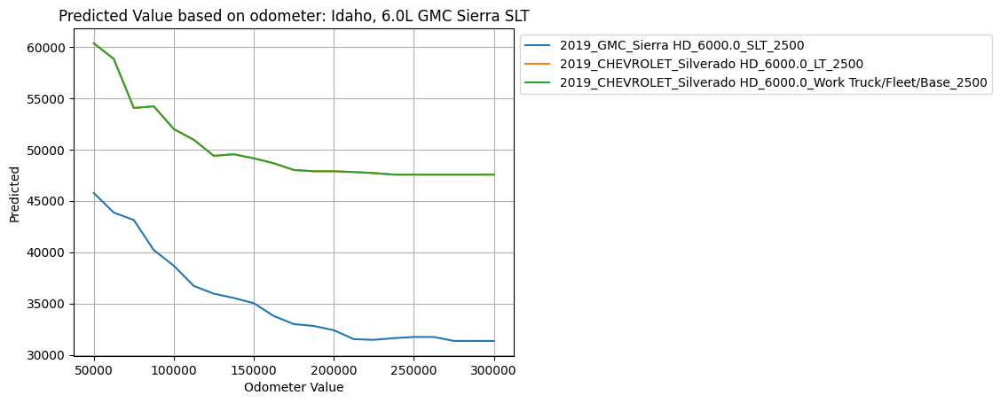

In [351]:
for label, df in r_dc.items():
    plt.plot(df['odometer'], df['predicted'], label=label)

# Set labels and title
plt.xlabel('Odometer Value')
plt.ylabel('Predicted')
plt.title('Predicted Value based on odometer: Idaho, 6.0L GMC Sierra SLT')
plt.grid(True)
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.show()

In [180]:
df_new5.loc[6214, subset]

Make                                                    CHEVROLET
Model                                                Silverado HD
BodyCabType                              Crew/Super Crew/Crew Max
VehicleType                                                 TRUCK
DriveType                                                     4WD
Turbo                                                           0
Trim                                                           LT
Trim2                                                         NaN
Series                                                       2500
Series2                                                       NaN
GVWR               Class 2H: 9,001 - 10,000 lb (4,082 - 4,536 kg)
BodyCabType                              Crew/Super Crew/Crew Max
Doors                                                         4.0
BodyClass                                                  Pickup
displ                                                      6000.0
EngineCyli

In [94]:
X.loc[118]

Doors                     4.0
EngineCylinders           8.0
SeatRows                  NaN
Seats                     NaN
TransmissionSpeeds        NaN
                       ...   
WheelSizeFront            NaN
WheelSizeRear             NaN
odometer              66368.0
ModelYear              2019.0
state_income            49671
Name: 118, Length: 5063, dtype: object

In [165]:
df_new5.loc[2006, subset]

Make                                                          GMC
Model                                                   Sierra HD
BodyCabType                              Crew/Super Crew/Crew Max
VehicleType                                                 TRUCK
DriveType                                                     4WD
Turbo                                                           0
Trim                                                          SLT
Trim2                                                         NaN
Series                                                       2500
Series2                                                       NaN
GVWR               Class 2H: 9,001 - 10,000 lb (4,082 - 4,536 kg)
BodyCabType                              Crew/Super Crew/Crew Max
Doors                                                         4.0
BodyClass                                                  Pickup
displ                                                      6600.0
EngineCyli

In [ ]:
6368,
 6843,
 8935,

In [166]:
df_new5.loc[6783, subset]

Make                                                    CHEVROLET
Model                                                Silverado HD
BodyCabType                              Crew/Super Crew/Crew Max
VehicleType                                                 TRUCK
DriveType                                                     4WD
Turbo                                                           1
Trim                                                           LT
Trim2                                                         NaN
Series                                                       2500
Series2                                                       NaN
GVWR               Class 2H: 9,001 - 10,000 lb (4,082 - 4,536 kg)
BodyCabType                              Crew/Super Crew/Crew Max
Doors                                                         4.0
BodyClass                                                  Pickup
displ                                                      6600.0
EngineCyli

In [ ]:
[6843,
 8935,
 8975,
 33068,
 34571,
 41843,
 42151,
 56649,
 68292,
 69045,
 70308,
 84907,
 84931,
 87735]

In [147]:
df_new5.loc[42151, subset]

Make                                                    CHEVROLET
Model                                                Silverado HD
BodyCabType                              Crew/Super Crew/Crew Max
VehicleType                                                 TRUCK
DriveType                                                     4WD
Turbo                                                           1
Trim                                                          LTZ
Trim2                                                         NaN
Series                                                       3500
Series2                                                       NaN
GVWR               Class 3: 10,001 - 14,000 lb (4,536 - 6,350 kg)
BodyCabType                              Crew/Super Crew/Crew Max
Doors                                                         4.0
BodyClass                                                  Pickup
displ                                                      6600.0
EngineCyli

In [139]:
df_new5.loc[68292, subset]

Make                                                    CHEVROLET
Model                                                Silverado HD
BodyCabType                              Crew/Super Crew/Crew Max
VehicleType                                                 TRUCK
DriveType                                                     4WD
Turbo                                                           1
Trim                                                          LTZ
Trim2                                                         NaN
Series                                                       3500
Series2                                                       NaN
GVWR               Class 3: 10,001 - 14,000 lb (4,536 - 6,350 kg)
BodyCabType                              Crew/Super Crew/Crew Max
Doors                                                         4.0
BodyClass                                                  Pickup
displ                                                      6600.0
EngineCyli

In [71]:
y = df_new5['price']
X = df_new5.drop(columns=['price'])

X_c = pd.get_dummies(X[cats])
X = pd.concat([X_c, X[nums]], axis=1)


In [362]:
def create_odometer_variations(row):
    new_rows = []
    
    # Loop through each value in the odometer range
    for odo_value in np.arange(0, 300001, 12500):
        new_row = row.copy()  # Make a copy of the original row
        new_row['odometer'] = odo_value  # Set the new odometer value
        new_rows.append(new_row)  # Add the modified row to the list
    
    # Convert the list of new rows to a DataFrame
    return pd.DataFrame(new_rows)

In [251]:
if df_new5.loc[68292, 'Trim']:
    print('trim')

trim


In [265]:
df_new5.loc[68292].dropna()

ABS                                        Standard
AirBagLocCurtain                           All Rows
AirBagLocFront       1st Row (Driver and Passenger)
AirBagLocSide        1st Row (Driver and Passenger)
AutoReverseSystem                          Standard
                                  ...              
long                                    -122.884236
posting_date              2021-04-28 16:15:15+00:00
Year                                           2019
displ                                        6600.0
state_income                                  61449
Name: 68292, Length: 75, dtype: object

In [264]:
df_new5.loc[118].dropna()

ABS                                                                 Standard
ActiveSafetySysNote        Standard:- Front and Rear Park Assist- Safety ...
AirBagLocCurtain                                                    All Rows
AirBagLocFront                                1st Row (Driver and Passenger)
AirBagLocSide                                 1st Row (Driver and Passenger)
BodyCabType                                         Crew/Super Crew/Crew Max
BodyClass                                                             Pickup
BrakeSystemType                                                    Hydraulic
DisplacementCC                                                        6600.0
Doors                                                                    4.0
DriveType                                                                4WD
ESC                                                                 Standard
EngineConfiguration                                                 V-Shaped

In [240]:
labs1

['2019.0_GMC_Sierra HD',
 '2019.0_CHEVROLET_Silverado HD',
 '2019.0_CHEVROLET_Silverado HD2']

In [241]:
len(list_df1)

3

In [261]:
df_new5.loc[6843, 'state']

'ca'

In [262]:
df_new5.loc[68292, 'state'](ref_i, list_of_idx, loaded_model, df)

'or'

In [595]:
labs1, list_df1 = predict_variations(118, [6843, 68292], model1, df_new5)

In [257]:
r_dc1 = dict(zip(labs1, list_df1))

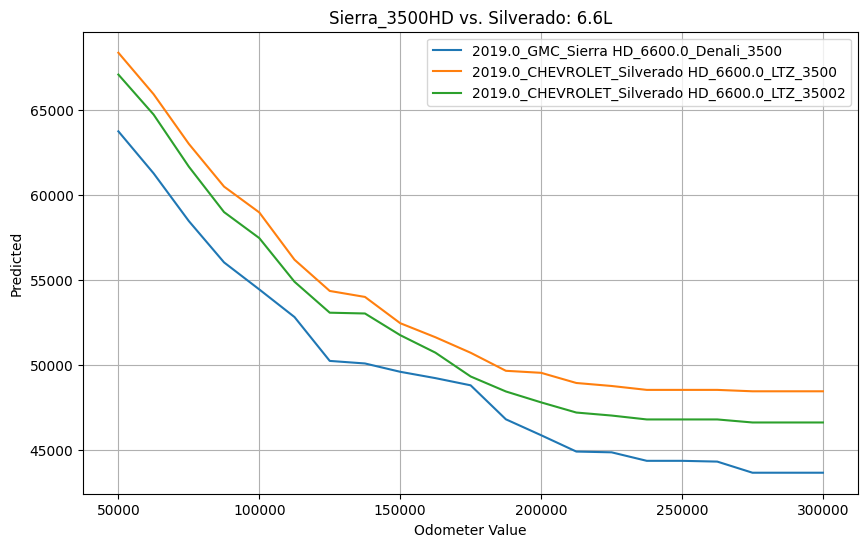

In [605]:
plt.figure(figsize=(10,6))
for label, df in r_dc1.items():
    plt.plot(df['odometer'], df['predicted'], label=label)


# Set labels and title
plt.xlabel('Odometer Value')
plt.ylabel('Predicted')
plt.title('Sierra_3500HD vs. Silverado: 6.6L')
plt.grid(True)
plt.legend()
plt.show()

In [596]:
r_dc2 = dict(zip(labs1, list_df1))

In [67]:
X_c = pd.get_dummies(df_new5.loc[118][cats])

In [73]:
df_slice = create_odometer_variations(X.loc[118])

In [75]:
df_unslice = create_odometer_variations(X.loc[1426])

In [77]:
booster = loaded_model.get_booster()
feature_names = booster.feature_names

In [78]:
df_unslice = df_unslice.reindex(columns=feature_names)
df_slice = df_slice.reindex(columns=feature_names)

In [80]:
df_slice.index

Index([118, 118, 118, 118, 118, 118, 118, 118, 118, 118, 118, 118, 118, 118,
       118, 118, 118, 118, 118, 118, 118],
      dtype='int64')

In [81]:
y_pred = loaded_model.predict(df_slice)

In [82]:
y_pred1 = loaded_model.predict(df_unslice)

In [87]:
df_slice['predicted'] = y_pred
df_unslice['predicted'] = y_pred1

In [438]:
matching_indices = []

for col in ['Series', 'Trim', 'Series2','Trim2', 'model']:
    # Filter rows where Turbo is 0 and the specified column contains 'turbo'
    indices = df_new5[(df_new5['EngineCylinders'] != 8) & (df_new5[col].str.contains('V8', case=False, na=False))].index
    matching_indices.extend(indices)

# Print or use the matching indices
print(matching_indices)

[28759, 55065, 55499, 36590]


In [437]:
#df_new5.loc[matching_indices, 'Turbo'] = 1

In [443]:
#df_new5.to_csv('df_n5.csv',index=False)

In [442]:
df_new5[df_new5.index.isin(matching_indices)][cols_to_not_match + ['EngineCylinders', 'model']]

,Make,Model,Series,Series2,Trim,Trim2,EngineCylinders,model
28759,VOLKSWAGEN,Touareg,V6 and V8 with Sport Suspension,NaN,NaN,NaN,6.0,touareg v6
36590,JAGUAR,XK8,NaN,NaN,NaN,NaN,4.0,xk8 convertible v8
55065,VOLKSWAGEN,Touareg,V6 and V8 with Sport Suspension,NaN,NaN,NaN,6.0,touareg
55499,VOLKSWAGEN,Touareg,V6 and V8 with Sport Suspension,NaN,NaN,NaN,6.0,touareg


In [430]:
df_new5.loc[73828, 'Turbo']

Make                                                         PORSCHE
Model                                                          Macan
BodyCabType                                                      NaN
VehicleType                     MULTIPURPOSE PASSENGER VEHICLE (MPV)
DriveType                                                        4WD
Turbo                                                              0
Trim                                                             NaN
Trim2                                                            NaN
Series                                                         Turbo
Series2                                                     Type 95B
GVWR                   Class 1D: 5,001 - 6,000 lb (2,268 - 2,722 kg)
BodyCabType                                                      NaN
Doors                                                            4.0
BodyClass          Sport Utility Vehicle (SUV)/Multi-Purpose Vehi...
displ                             

In [58]:
df_118 = dummies_odometer_range(df_new5.loc[118], df_new5)

C:\Users\pgrts\AppData\Local\Temp\ipykernel_2696\127133088.py:17: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_mask[cols] = 0
C:\Users\pgrts\AppData\Local\Temp\ipykernel_2696\127133088.py:17: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_mask[cols] = 0
C:\Users\pgrts\AppData\Local\Temp\ipykernel_2696\127133088.py:17: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) in

In [119]:
def dummies_odometer_range(df):
    
    X_c_mask = pd.get_dummies(df[cats])
    X_mask = pd.concat([X_c_mask, df[nums]], axis=1)
    
    for col in X_c.columns:
        if col not in X_mask.columns:
            X_mask[col] = 0
            
    new_rows = []

    # Loop through each value in the odo_range
    for odo_value in np.arange(50000, 300001, 25000):
        # Create a new row for each original row with the new odometer value
        for _, row in X_mask.iterrows():
            new_row = row.copy()
            new_row['odometer'] = odo_value  # Set the new odometer value
            new_rows.append(new_row)
    
    # Convert the list of new rows to a DataFrame
    new_df = pd.DataFrame(new_rows)
    return new_df

In [91]:
#y = df_masked['price']
#X = df_masked.drop(columns=['price'])

X_c_mask = pd.get_dummies(df_masked[cats])
X_mask = pd.concat([X_c_mask, df_masked[nums]], axis=1)

In [95]:
X_mask.columns

Index(['Doors', 'EngineCylinders', 'SeatRows', 'Seats', 'TransmissionSpeeds',
       'Turbo', 'Make_GMC', 'state_ak', 'state_al', 'state_ar', 'state_ca',
       'state_fl', 'state_id', 'state_wa', 'Model_Sierra HD', 'Trim_Denali',
       'Trim_Fleet/Base', 'Trim_SLE', 'Trim_SLT', 'Series_2500', 'Series_3500',
       'region_anchorage / mat-su', 'region_bakersfield', 'region_bellingham',
       'region_birmingham', 'region_boise', 'region_east idaho',
       'region_fayetteville', 'region_ft myers / SW florida',
       'region_lewiston / clarkston', 'ABS_Standard',
       'AirBagLocCurtain_All Rows',
       'AirBagLocFront_1st Row (Driver and Passenger)',
       'AirBagLocSide_1st Row (Driver and Passenger)',
       'BodyCabType_Crew/Super Crew/Crew Max', 'BodyClass_Pickup',
       'BrakeSystemType_Hydraulic', 'DriveType_4WD', 'ESC_Standard',
       'EngineConfiguration_V-Shaped', 'ForwardCollisionWarning_Optional',
       'ForwardCollisionWarning_Standard', 'FuelTypePrimary_Diesel',
  

In [99]:
for col in X_c.columns:
    if col not in X_mask.columns:
        X_mask[col] = 0

C:\Users\pgrts\AppData\Local\Temp\ipykernel_3924\2424336502.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_mask[col] = 0
C:\Users\pgrts\AppData\Local\Temp\ipykernel_3924\2424336502.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_mask[col] = 0
C:\Users\pgrts\AppData\Local\Temp\ipykernel_3924\2424336502.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) inst

In [101]:
len(X.columns) == len(X_mask.columns)

True

In [104]:
[x for x in nums if x not in X_mask.columns]

[]

In [105]:
X_mask[nums]

,BasePrice,EngineHP,EngineHP_to,displ,TopSpeedMPH,WheelBaseShort,WheelSizeFront,WheelSizeRear,odometer,ModelYear,state_income
118,NaN,NaN,NaN,6600.0,NaN,NaN,NaN,NaN,66368.0,2019.0,49671
2006,NaN,NaN,NaN,6600.0,NaN,NaN,NaN,NaN,59582.0,2019.0,65677
5817,NaN,NaN,NaN,6600.0,NaN,NaN,NaN,NaN,92127.0,2019.0,50588
6574,NaN,NaN,NaN,6600.0,NaN,NaN,NaN,NaN,25854.0,2019.0,76800
25486,NaN,NaN,NaN,6000.0,NaN,NaN,NaN,NaN,101928.0,2019.0,62136
33184,NaN,NaN,NaN,6600.0,NaN,NaN,NaN,NaN,16757.0,2019.0,52276
33800,NaN,NaN,NaN,6000.0,NaN,NaN,NaN,NaN,23636.0,2019.0,52276
34349,NaN,NaN,NaN,6600.0,NaN,NaN,NaN,NaN,15837.0,2019.0,52276
84173,NaN,NaN,NaN,6600.0,NaN,NaN,NaN,NaN,14367.0,2019.0,73755
84730,NaN,NaN,NaN,6000.0,NaN,NaN,NaN,NaN,16620.0,2019.0,73755


In [106]:
new_rows = []

# Loop through each value in the odo_range
for odo_value in np.arange(50000, 300001, 25000):
    # Create a new row for each original row with the new odometer value
    for _, row in X_mask.iterrows():
        new_row = row.copy()
        new_row['odometer'] = odo_value  # Set the new odometer value
        new_rows.append(new_row)

# Convert the list of new rows to a DataFrame
new_df = pd.DataFrame(new_rows)

In [107]:
new_df

,Doors,EngineCylinders,SeatRows,Seats,TransmissionSpeeds,Turbo,Make_GMC,state_ak,state_al,state_ar,...,condition_fair,paint_color_brown,paint_color_custom,paint_color_green,paint_color_grey,paint_color_orange,paint_color_purple,paint_color_red,paint_color_silver,paint_color_yellow
118,4.0,8.0,NaN,NaN,NaN,0,True,False,True,False,...,0,0,0,0,0,0,0,0,0,0
2006,4.0,8.0,NaN,NaN,NaN,0,True,True,False,False,...,0,0,0,0,0,0,0,0,0,0
5817,4.0,8.0,NaN,NaN,NaN,0,True,False,False,True,...,0,0,0,0,0,0,0,0,0,0
6574,4.0,8.0,NaN,NaN,NaN,0,True,False,False,False,...,0,0,0,0,0,0,0,0,0,0
25486,4.0,8.0,NaN,NaN,NaN,0,True,False,False,False,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33184,4.0,8.0,NaN,NaN,NaN,0,True,False,False,False,...,0,0,0,0,0,0,0,0,0,0
33800,4.0,8.0,NaN,NaN,NaN,0,True,False,False,False,...,0,0,0,0,0,0,0,0,0,0
34349,4.0,8.0,NaN,NaN,NaN,0,True,False,False,False,...,0,0,0,0,0,0,0,0,0,0
84173,4.0,8.0,NaN,NaN,NaN,0,True,False,False,False,...,0,0,0,0,0,0,0,0,0,0


In [70]:
[x for x in X.columns if x not in new_dummies.columns]

[]

In [589]:
from sklearn.model_selection import train_test_split

y = df_new5['price']
X = df_new5.drop(columns=['price'])

X_c = pd.get_dummies(X[cats1])
X = pd.concat([X_c, X[nums1]], axis=1)

# Perform train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=32)

In [590]:
model1 = XGBRegressor(**{'subsample': 0.8,
 'scale_pos_weight': 2,
 'objective': 'reg:squarederror',
 'n_estimators': 175,
 'min_child_weight': 9,
 'max_depth': 13,
 'learning_rate': 0.05,
 'lambda': 1.5,
 'colsample_bytree': 0.8,
 'colsample_bynode': 0.4,
 'colsample_bylevel': 0.8})

# Fit the model on the training data
model1.fit(X_train, y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=0.8, colsample_bynode=0.4, colsample_bytree=0.8,
             device=None, early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=None, grow_policy=None,
             importance_type=None, interaction_constraints=None, lambda=1.5,
             learning_rate=0.05, max_bin=None, max_cat_threshold=None,
             max_cat_to_onehot=None, max_delta_step=None, max_depth=13,
             max_leaves=None, min_child_weight=9, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=175,
             n_jobs=None, num_parallel_tree=None, ...)

In [591]:
from sklearn.metrics import mean_squared_error

y_pred = model1.predict(X_test)

# Calculate the mean squared error
mse = mean_squared_error(y_test, y_pred)

# Print the result
print(f'Mean Squared Error: {mse}')

Mean Squared Error: 8058501.400818393


In [592]:
np.sqrt(mse)

2838.749971522394

In [593]:
model1.save_model('xgb_model_nostate.json')

In [118]:
new_df_aligned.columns

Index(['Doors', 'EngineCylinders', 'SeatRows', 'Seats', 'TransmissionSpeeds',
       'Turbo', 'Make_ACURA', 'Make_ALFA ROMEO', 'Make_AUDI', 'Make_BMW',
       ...
       'EngineHP', 'EngineHP_to', 'displ', 'TopSpeedMPH', 'WheelBaseShort',
       'WheelSizeFront', 'WheelSizeRear', 'odometer', 'ModelYear',
       'state_income'],
      dtype='object', length=5063)

In [74]:
'EngineHP' in new_dummies.columns

True

In [39]:
from sklearn.model_selection import train_test_split
def run_model(df, model):
    y = df['price']
    X = df.drop(columns=['price'])
    
    X_c = pd.get_dummies(X[cats])
    X = pd.concat([X_c, X[nums]], axis=1)
    
    # Perform train-test split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=32)

    y_pred = model.predict(X_test)
    return y_pred